In [1]:
! pip install wyn-pm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.0/13.0 MB 36.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 70.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 80.8 MB/s eta 0:00:00
  Attempting uninstall: plotly
    Found existing installation: plotly 5.15.0
    Uninstalling plotly-5.15.0:
      Successfully uninstalled plotly-5.15.0
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2
  Attempting uninstall: pandas
    Found existing installation: pandas 2.0.3
    Uninstalling pandas-2.0.3:
      Successfully uninstalled pandas-2.0.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pandas<2.2.2dev0,>=2.0, but you have pandas 2.2.2 which is incompatible.


In [2]:
from wyn_pm.stock_analyzer import *

In [3]:
# Example usage:
stock_analysis = StockAnalysis(ticker="AAPL")
stock_analysis.fetch_data()
stock_analysis.calculate_macd()
stock_analysis.find_crossovers(bullish_threshold=-4, bearish_threshold=4)
fig = stock_analysis.create_fig()
fig.show()

In [4]:
from wyn_pm.efficient_portfolio import *

[*********************100%%**********************]  3 of 3 completed


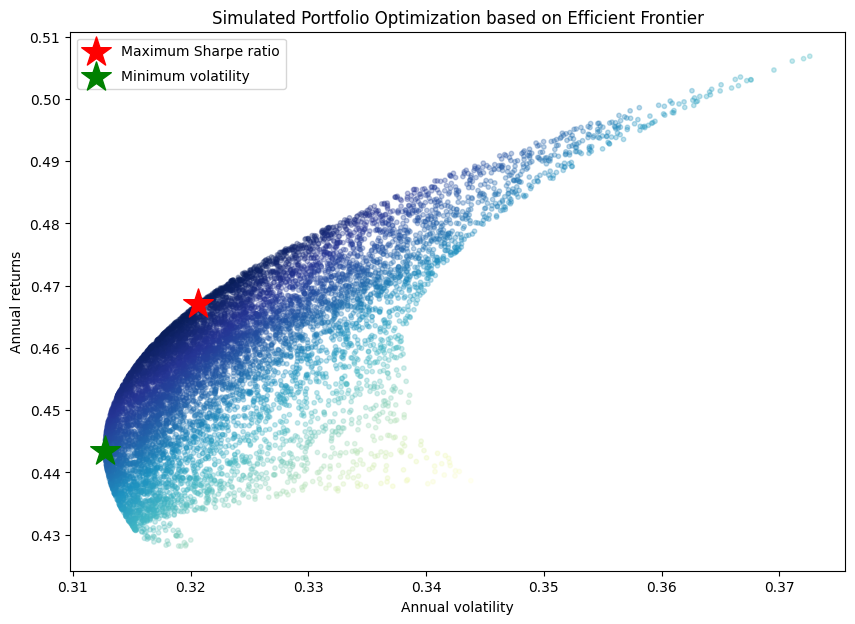

{'Annualised Return': 0.47, 'Annualised Volatility': 0.32, 'Max Sharpe Allocation':              AAPL   MSFT  GOOGL
allocation  49.36  50.62   0.02, 'Max Sharpe Allocation in Percentile':               AAPL    MSFT   GOOGL
allocation  0.4936  0.5062  0.0002, 'Min Volatility Allocation':             AAPL   MSFT  GOOGL
allocation  18.0  65.19  16.81, 'Min Volatility Allocation in Percentile':             AAPL    MSFT   GOOGL
allocation  0.18  0.6519  0.1681}


In [5]:
# Example usage:
portfolio = EfficientPortfolio(tickers=["AAPL", "MSFT", "GOOGL"], start_date="2020-01-01", end_date="2022-01-01", interval="1d")
stock_data = portfolio.download_stock_data()
portfolio_returns = portfolio.create_portfolio_and_calculate_returns(top_n=5)

# Calculate mean returns and covariance matrix
mean_returns = stock_data.pct_change().mean()
cov_matrix = stock_data.pct_change().cov()

# Define the number of portfolios to simulate and the risk-free rate
num_portfolios = 10000
risk_free_rate = 0.01

# Display the efficient frontier with randomly generated portfolios
fig, details = portfolio.display_simulated_ef_with_random(mean_returns.values, cov_matrix.values, num_portfolios, risk_free_rate)
plt.show()

# Print details of the max Sharpe and min volatility portfolios
print(details)

In [6]:
from wyn_pm.trainer import *

In [6]:
from typing import List, Tuple
import math
from datetime import datetime

import numpy as np
import pandas as pd
import plotly.graph_objects as go
import tensorflow as tf
import yfinance as yf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers import GRU, LSTM, Dense, Dropout, SimpleRNN
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import SGD, Adam


class StockModeling:
    def __init__(self):
        """
        Initialize the StockModeling class.
        """
        pass

    @staticmethod
    def current_year() -> int:
        """
        Get the current year.

        Returns:
            int: The current year.
        """
        now = datetime.now()
        return now.year

    @staticmethod
    def create_rnn_model(input_shape: Tuple) -> tf.keras.Model:
        """
        Constructs a Recurrent Neural Network (RNN) model with multiple SimpleRNN layers and dropout regularization,
        followed by a Dense output layer. The model is compiled with the SGD optimizer.

        Args:
            input_shape (tuple): A tuple representing the input shape of the training data, excluding the batch size.
                                 For example, (timesteps, features).

        Returns:
            tf.keras.Model: The constructed and compiled TensorFlow model.
        """
        regressor = Sequential()
        regressor.add(
            SimpleRNN(
                units=50,
                activation="tanh",
                return_sequences=True,
                input_shape=input_shape,
            )
        )
        regressor.add(Dropout(0.2))
        regressor.add(SimpleRNN(units=50, activation="tanh", return_sequences=True))
        regressor.add(SimpleRNN(units=50, activation="tanh", return_sequences=True))
        regressor.add(SimpleRNN(units=50, activation="tanh"))
        regressor.add(Dense(units=1, activation="sigmoid"))
        regressor.compile(
            optimizer=SGD(learning_rate=0.01, momentum=0.9, nesterov=True),
            loss="mean_squared_error",
        )
        return regressor

    @staticmethod
    def create_lstm_model(input_shape: Tuple) -> tf.keras.Model:
        """
        Constructs a Long Short-Term Memory (LSTM) model with LSTM layers and a Dense layer,
        followed by a Dense output layer. The model is compiled with the Adam optimizer.

        Args:
            input_shape (tuple): A tuple representing the input shape of the training data, excluding the batch size.
                                 For example, (timesteps, features).

        Returns:
            tf.keras.Model: The constructed and compiled TensorFlow model.
        """
        regressorLSTM = Sequential()
        regressorLSTM.add(LSTM(50, return_sequences=True, input_shape=input_shape))
        regressorLSTM.add(LSTM(50, return_sequences=False))
        regressorLSTM.add(Dense(25))
        regressorLSTM.add(Dense(1))
        regressorLSTM.compile(
            optimizer="adam", loss="mean_squared_error", metrics=["accuracy"]
        )
        return regressorLSTM

    @staticmethod
    def create_gru_model(input_shape: Tuple) -> tf.keras.Model:
        """
        Constructs a Gated Recurrent Unit (GRU) model with multiple GRU layers including dropout for regularization,
        and a Dense output layer. The model is compiled with the SGD optimizer.

        Args:
            input_shape (tuple): A tuple representing the input shape of the training data, excluding the batch size.
                                 For example, (timesteps, features).

        Returns:
            tf.keras.Model: The constructed and compiled TensorFlow model.
        """
        regressorGRU = Sequential()
        regressorGRU.add(
            GRU(
                units=50,
                return_sequences=True,
                input_shape=input_shape,
                activation="tanh",
            )
        )
        regressorGRU.add(Dropout(0.2))
        regressorGRU.add(GRU(units=50, return_sequences=True, activation="tanh"))
        regressorGRU.add(GRU(units=50, return_sequences=True, activation="tanh"))
        regressorGRU.add(GRU(units=50, activation="tanh"))
        regressorGRU.add(Dense(units=1, activation="relu"))
        regressorGRU.compile(
            optimizer=SGD(learning_rate=0.01, momentum=0.9, nesterov=False),
            loss="mean_squared_error",
        )
        return regressorGRU

    @staticmethod
    def download_data(stock: str, start_date: str, end_date: str) -> pd.DataFrame:
        """
        Download stock data from Yahoo Finance.

        Args:
            stock (str): The stock ticker symbol.
            start_date (str): The start date for the data in 'YYYY-MM-DD' format.
            end_date (str): The end date for the data in 'YYYY-MM-DD' format.

        Returns:
            pd.DataFrame: The downloaded stock data.
        """
        data = yf.download(stock, start=start_date, end=end_date)
        return data

    @staticmethod
    def prepare_data(data: pd.Series) -> Tuple[np.ndarray, MinMaxScaler]:
        """
        Scale the data using MinMaxScaler.

        Args:
            data (pd.Series): The input data to be scaled.

        Returns:
            Tuple[np.ndarray, MinMaxScaler]: The scaled data and the scaler object.
        """
        scaler = MinMaxScaler(feature_range=(0, 1))
        data_scaled = scaler.fit_transform(data.values.reshape(-1, 1))
        return data_scaled, scaler

    @staticmethod
    def create_datasets(
        data_scaled: np.ndarray, look_back: int = 50
    ) -> Tuple[np.ndarray, np.ndarray]:
        """
        Create datasets for training the model.

        Args:
            data_scaled (np.ndarray): The scaled input data.
            look_back (int): The number of previous time steps to use as input variables.

        Returns:
            Tuple[np.ndarray, np.ndarray]: The input and output datasets.
        """
        X, y = [], []
        for i in range(look_back, len(data_scaled)):
            X.append(data_scaled[i - look_back : i, 0])
            y.append(data_scaled[i, 0])
        X, y = np.array(X), np.array(y)
        print("------------------------------------------------------------")
        print("Note: Verify that at this step the shape of X is: ", X.shape)
        print("Note: Verify that at this step the shape of y is: ", y.shape)
        print("------------------------------------------------------------")
        X = np.reshape(X, (X.shape[0], X.shape[1], 1))
        return X, y

    @staticmethod
    def plot_predictions(
        train_data: pd.DataFrame,
        test_data: pd.DataFrame,
        y_train_pred: np.ndarray,
        y_test_pred: np.ndarray,
        model_name: str,
        look_back: int = 50,
    ) -> go.Figure:
        """
        Plot the training and test data predictions.

        Args:
            train_data (pd.DataFrame): The training data.
            test_data (pd.DataFrame): The test data.
            y_train_pred (np.ndarray): The predicted values for the training data.
            y_test_pred (np.ndarray): The predicted values for the test data.
            model_name (str): The name of the model.
            look_back (int): The number of previous time steps to use as input variables.

        Returns:
            go.Figure: The Plotly figure object.
        """
        fig = go.Figure()
        fig.add_trace(
            go.Scatter(
                x=train_data.index,
                y=train_data.values.flatten(),
                mode="lines",
                name="Training Data",
            )
        )
        fig.add_trace(
            go.Scatter(
                x=test_data.index,
                y=test_data.values.flatten(),
                mode="lines",
                name="Test Data",
            )
        )
        fig.add_trace(
            go.Scatter(
                x=test_data.index[look_back:],
                y=y_test_pred,
                mode="lines",
                name="Predicted Data",
            )
        )
        fig.update_layout(
            title=f"{model_name} Predictions",
            xaxis_title="Date",
            yaxis_title="Stock Price",
        )
        return fig

    @staticmethod
    def plot_monte_carlo_forecasts(
        data: pd.DataFrame,
        n_futures: int,
        n_samples: int,
        mean_return: float,
        std_dev: float,
    ) -> go.Figure:
        """
        Simulate future stock price paths using the Monte Carlo method and visualize the results using Plotly.

        Args:
            data (pd.DataFrame): Stock data containing at least the 'Close' prices.
            n_futures (int): Number of days in the future to simulate.
            n_samples (int): Number of simulation paths to generate.
            mean_return (float): The mean return for the stock.
            std_dev (float): The standard deviation of the stock returns.

        Returns:
            go.Figure: The Plotly figure object.
        """
        closing_prices = data["Close"]
        last_close = closing_prices.iloc[-1]
        fig = go.Figure()
        fig.add_trace(
            go.Scatter(
                x=closing_prices.index,
                y=closing_prices,
                mode="lines",
                name="Historical Closing Price",
            )
        )

        for _ in range(n_samples):
            future_returns = np.random.normal(mean_return, std_dev, n_futures)
            future_prices = last_close * (np.cumprod(future_returns + 1))
            future_dates = pd.date_range(
                start=closing_prices.index[-1], periods=n_futures + 1, freq="B"
            )[1:]
            fig.add_trace(
                go.Scatter(x=future_dates, y=future_prices, mode="lines", opacity=0.5)
            )

        fig.update_layout(
            title=f"Monte Carlo Simulations for Next {n_futures} Days",
            xaxis_title="Date",
            yaxis_title="Simulated Stock Price",
            showlegend=True,
            legend_title="Legend",
        )

        return fig

    def forecast_and_plot(self, stock: str, start_date: str, end_date: str, look_back: int, num_of_epochs: int, n_futures: int, n_samples: int, verbose_style: int) -> Tuple[pd.DataFrame, go.Figure]:
        """
        Forecast the next point for the given stock using RNN, LSTM, and GRU models, and plot Monte Carlo simulations.

        Args:
            stock (str): The stock ticker symbol.
            start_date (str): The start date for the data in 'YYYY-MM-DD' format.
            end_date (str): The end date for the data in 'YYYY-MM-DD' format.
            look_back (int): The number of previous time steps to use as input variables.
            num_of_epochs (int): The number of epochs for training the models.
            n_futures (int): The number of days in the future to simulate.
            n_samples (int): The number of simulation paths to generate.
            verbose_style (int): The style for verbose output.

        Returns:
            Tuple[pd.DataFrame, go.Figure]: The forecast results table and the Monte Carlo simulation figure.
        """
        data = self.download_data(stock, start_date, end_date)

        # Setting 80 percent data for training
        training_data_len = math.ceil(len(data) * 0.8)

        # Splitting the dataset
        train_data = data[:training_data_len].iloc[:, :5]
        test_data = data[training_data_len:].iloc[:, :5]

        # Selecting Close Price values
        dataset_train = train_data.Close.values

        # Reshaping 1D to 2D array
        dataset_train = np.reshape(dataset_train, (-1, 1))

        # Scaling dataset
        scaler = MinMaxScaler(feature_range=(0, 1))
        scaled_train = scaler.fit_transform(dataset_train)

        # Selecting Close Price values
        dataset_test = test_data.Close.values

        # Reshaping 1D to 2D array
        dataset_test = np.reshape(dataset_test, (-1, 1))

        # Normalizing values between 0 and 1
        scaled_test = scaler.fit_transform(dataset_test)

        # Split train and test
        X_train, y_train = self.create_datasets(scaled_train, look_back)
        X_test, y_test = self.create_datasets(scaled_test, look_back)

        # Create models
        rnn_model = self.create_rnn_model((look_back, 1))
        lstm_model = self.create_lstm_model((look_back, 1))
        gru_model = self.create_gru_model((look_back, 1))

        # Training
        rnn_model.fit(X_train, y_train, epochs=num_of_epochs, batch_size=1, verbose=verbose_style)
        lstm_model.fit(X_train, y_train, epochs=num_of_epochs, batch_size=1, verbose=verbose_style)
        gru_model.fit(X_train, y_train, epochs=num_of_epochs, batch_size=1, verbose=verbose_style)
        print("Models finished training.")

        # Inference
        y_RNN = []
        y_LSTM = []
        y_GRU = []
        starter_data = scaled_test[-look_back:].reshape((look_back, 1)).reshape((-1, look_back, 1))

        for _ in range(1):
            curr_y_RNN = rnn_model.predict(starter_data, verbose=0)
            curr_y_LSTM = lstm_model.predict(starter_data, verbose=0)
            curr_y_GRU = gru_model.predict(starter_data, verbose=0)

            curr_y_RNN = scaler.inverse_transform(curr_y_RNN)
            curr_y_LSTM = scaler.inverse_transform(curr_y_LSTM)
            curr_y_GRU = scaler.inverse_transform(curr_y_GRU)

            y_RNN.append(curr_y_RNN)
            y_LSTM.append(curr_y_LSTM)
            y_GRU.append(curr_y_GRU)

        y_RNN = np.array(y_RNN).flatten()[0]
        y_LSTM = np.array(y_LSTM).flatten()[0]
        y_GRU = np.array(y_GRU).flatten()[0]

        next_point_forecasts = np.array([y_RNN, y_LSTM, y_GRU]).reshape(-1)

        closing_prices = data['Close']
        last_close = closing_prices.iloc[-1]
        forecast_results_tab = pd.DataFrame({
            'Last Close': last_close,
            'RNN': y_RNN,
            'LSTM': y_LSTM,
            'GRU': y_GRU,
            'Average': np.mean(next_point_forecasts),
            'Median': np.median(next_point_forecasts),
            'Std Dev': np.std(next_point_forecasts)
        }, index=[0])
        forecast_results_tab = forecast_results_tab.transpose()

        # Create MC Simulation
        all_rets = next_point_forecasts / last_close - 1
        mean_return = np.mean(all_rets)
        std_dev = np.std(all_rets)
        fig = self.plot_monte_carlo_forecasts(data=data, n_futures=n_futures, n_samples=n_samples, mean_return=mean_return, std_dev=std_dev)

        return forecast_results_tab, fig

In [8]:
%%time

# Example usage:
stock_modeling = StockModeling()

# Training
forecast_results, mc_figure = stock_modeling.forecast_and_plot(stock="AAPL", start_date="2020-01-01", end_date="2023-01-01", look_back=50, num_of_epochs=10, n_futures=365, n_samples=1000, verbose_style=1)

# Results
print(forecast_results)
mc_figure.show()

[*********************100%%**********************]  1 of 1 completed


------------------------------------------------------------
Note: Verify that at this step the shape of X is:  (555, 50)
Note: Verify that at this step the shape of y is:  (555,)
------------------------------------------------------------
------------------------------------------------------------
Note: Verify that at this step the shape of X is:  (101, 50)
Note: Verify that at this step the shape of y is:  (101,)
------------------------------------------------------------
Epoch 1/10
555/555 [==============================] - 51s 86ms/step - loss: 0.0189
Epoch 2/10
555/555 [==============================] - 48s 87ms/step - loss: 0.0035
Epoch 3/10
555/555 [==============================] - 48s 86ms/step - loss: 0.0028
Epoch 4/10
555/555 [==============================] - 48s 87ms/step - loss: 0.0024
Epoch 5/10
555/555 [==============================] - 48s 86ms/step - loss: 0.0025
Epoch 6/10
555/555 [==============================] - 48s 86ms/step - loss: 0.0021
Epoch 7/10
555/555 [

CPU times: user 14min 23s, sys: 1min 16s, total: 15min 40s
Wall time: 9min 55s


In [9]:
%%time

# Example usage:
stock_modeling = StockModeling()

# Training
with tf.device('/device:GPU:0'):
    forecast_results, mc_figure = stock_modeling.forecast_and_plot(stock="AAPL", start_date="2020-01-01", end_date="2023-01-01", look_back=50, num_of_epochs=10, n_futures=365, n_samples=1000, verbose_style=1)

# Results
print(forecast_results)
mc_figure.show()

[*********************100%%**********************]  1 of 1 completed

------------------------------------------------------------
Note: Verify that at this step the shape of X is:  (555, 50)
Note: Verify that at this step the shape of y is:  (555,)
------------------------------------------------------------
------------------------------------------------------------
Note: Verify that at this step the shape of X is:  (101, 50)
Note: Verify that at this step the shape of y is:  (101,)
------------------------------------------------------------


Epoch 1/10
555/555 [==============================] - 52s 88ms/step - loss: 0.0513
Epoch 2/10
555/555 [==============================] - 49s 89ms/step - loss: 0.0365
Epoch 3/10
555/555 [==============================] - 49s 87ms/step - loss: 0.0103
Epoch 4/10
555/555 [==============================] - 49s 87ms/step - loss: 0.0077
Epoch 5/10
555/555 [==============================] - 49s 89ms/step - loss: 0.0051
Epoch 6/10
555/555 [==============================] - 49s 88ms/step - loss: 0.0036
Epoch 7/10
555/555 [==============================] - 49s 89ms/step - loss: 0.0033
Epoch 8/10
555/555 [==============================] - 48s 87ms/step - loss: 0.0033
Epoch 9/10
555/555 [==============================] - 49s 88ms/step - loss: 0.0025
Epoch 10/10
555/555 [==============================] - 49s 87ms/step - loss: 0.0026
Epoch 1/10
555/555 [==============================] - 6s 7ms/step - loss: 0.0059 - accuracy: 0.0036
Epoch 2/10
555/555 [==============================] - 4s 6ms/step - l

                     0
Last Close  129.929993
RNN         135.148666
LSTM        128.881302
GRU         126.040001
Average     130.023331
Median      128.881302
Std Dev       3.805269


CPU times: user 14min 31s, sys: 1min 16s, total: 15min 47s
Wall time: 10min 2s
